In [2]:
from matplotlib import cm
import anndata as ad
import squidpy as sq
import cellcharter as cc
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

 captum (see https://github.com/pytorch/captum).
Global seed set to 0


In [1]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
adata = ad.read_h5ad('data/codex_mouse_spleen/BALBc-MRL_trVAE_STAGATE_CellCharter.h5ad')

In [4]:
adata.obs['condition'] = adata.obs['sample'].str.split('-').str[0].astype('category')

In [5]:
adata.obs_names_make_unique()

In [6]:
cluster2region = {
    3: 'C1 - artifact',
    5: 'C2 - B-PALS boundary',
    7: 'C3 - B-follicle',
    1: 'C4 - marginal zone',
    0: 'C5 - PALS',
    8: 'C6 - PALS (DCs+)',
    9: 'C7 - red pulp (B cells+)', 
    2: 'C8 - red pulp (erythroblasts+)', 
    4: 'C9 - red pulp (NKs+)', 
    6: 'C10 - vasculature',
    10: 'C11 - vasculature (granulocytes+)', 
}

In [7]:
adata.obs['spatial_cluster'] = adata.obs['cluster_11'].map(cluster2region)
adata.obs['spatial_cluster'] = adata.obs['spatial_cluster'].astype('category')
adata.obs['spatial_cluster'] = adata.obs['spatial_cluster'].cat.reorder_categories(list(cluster2region.values()))

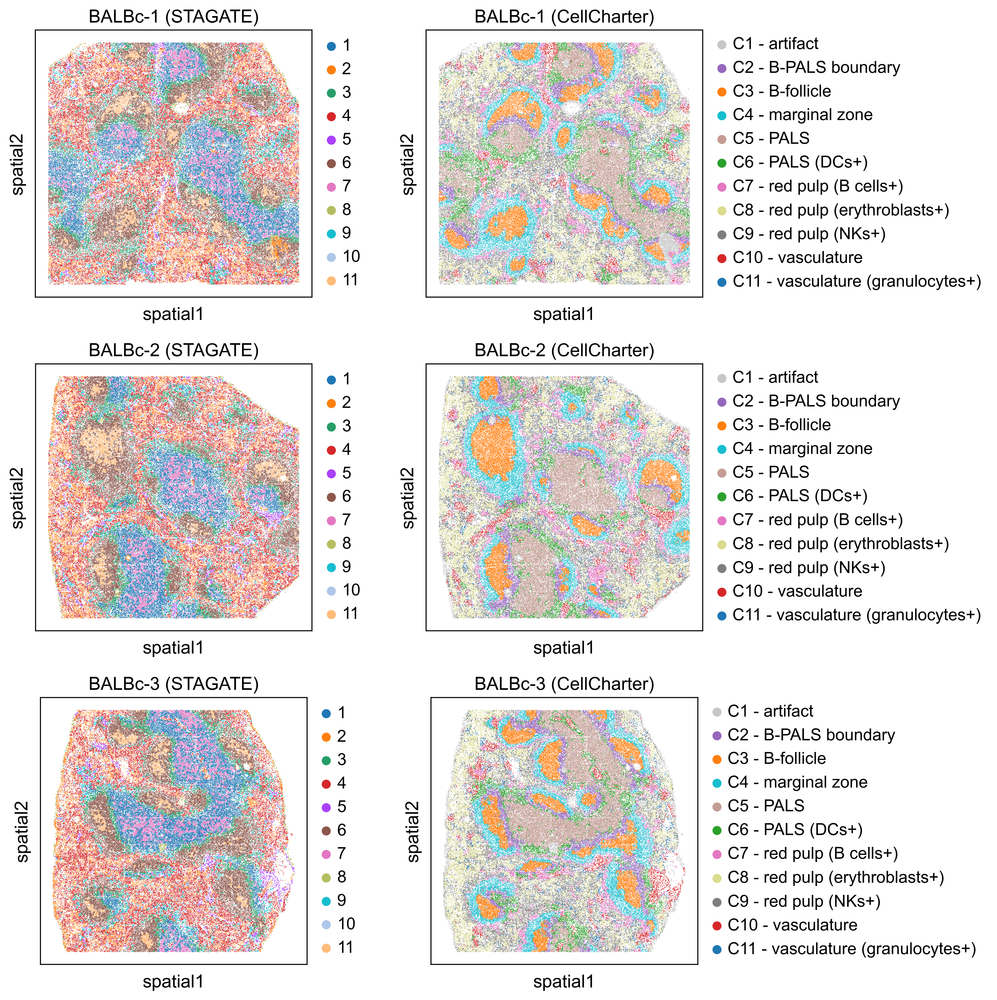

In [8]:
sq.pl.spatial_scatter(
    adata,
    color=['mclust', 'spatial_cluster'],
    img=None,
    library_key='sample',
    library_id = ['BALBc-1', 'BALBc-2', 'BALBc-3'],
    size=2500,
    ncols=2,
    title=['BALBc-1 (STAGATE)', 'BALBc-1 (CellCharter)', 'BALBc-2 (STAGATE)', 'BALBc-2 (CellCharter)', 'BALBc-3 (STAGATE)', 'BALBc-3 (CellCharter)']
)

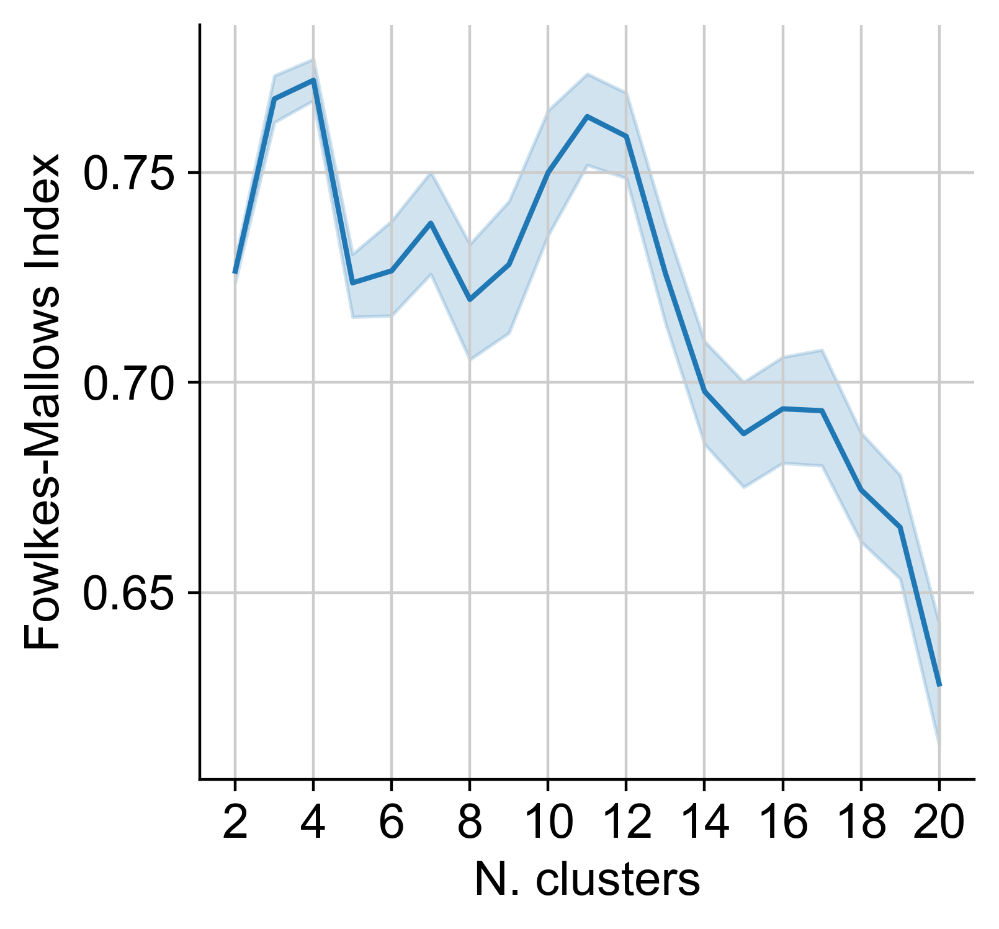

In [9]:
autok = cc.tl.ClusterAutoK.load('data/codex_mouse_spleen/BALBc-MRL_trVAE_CellCharter_autok')
cc.pl.autok_stability(autok)
plt.xticks(np.arange(autok.n_clusters[1], autok.n_clusters[-1], 2))
plt.ylabel('Fowlkes-Mallows Index')
plt.show()

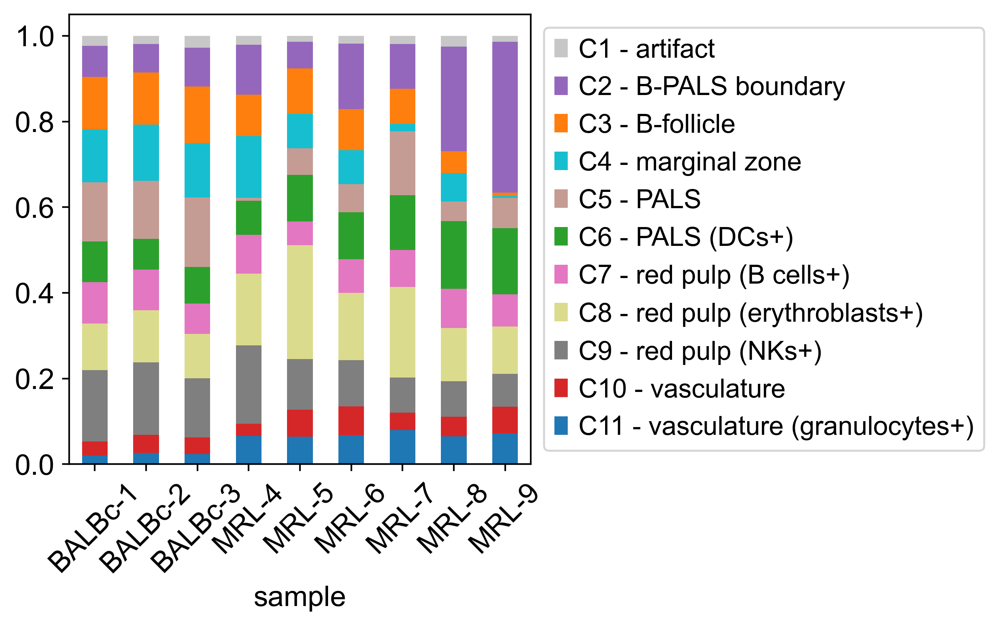

In [10]:
cc.pl.proportion(
    adata,
    group_key='sample',
    label_key='spatial_cluster',
    palette=list(adata.uns['spatial_cluster_colors'])
)

In [11]:
adata.obs['cell_type_reduced'] = pd.Categorical(adata.obs['cell_type'].replace({
    'CD4(+)CD8(-)cDC': 'DCs',
    'CD4(-)CD8(+)cDC': 'DCs',
    'CD4(-)CD8(-) cDC': 'DCs',
    'CD106(+)CD16/32(+)CD31(+) stroma': 'stroma',
    'CD106(+)CD16/32(+)CD31(-)Ly6C(-) stroma': 'stroma',
    'CD106(-)CD16/32(-)Ly6C(+)CD31(+) stroma': 'stroma',
    'ERTR7(+) stroma': 'stroma',
    'CD3(+) other markers (-)': 'other',
    'CD106(+)CD16/32(-)Ly6C(+)CD31(+)': 'other',
    'CD106(-)CD16/32(+)Ly6C(+)CD31(-)': 'other',
    'CD3(+) other markers (-)': 'other',
    'noid': 'other',
    'CD4(+)MHCII(+)': 'other',
    'capsule': 'other'
}))

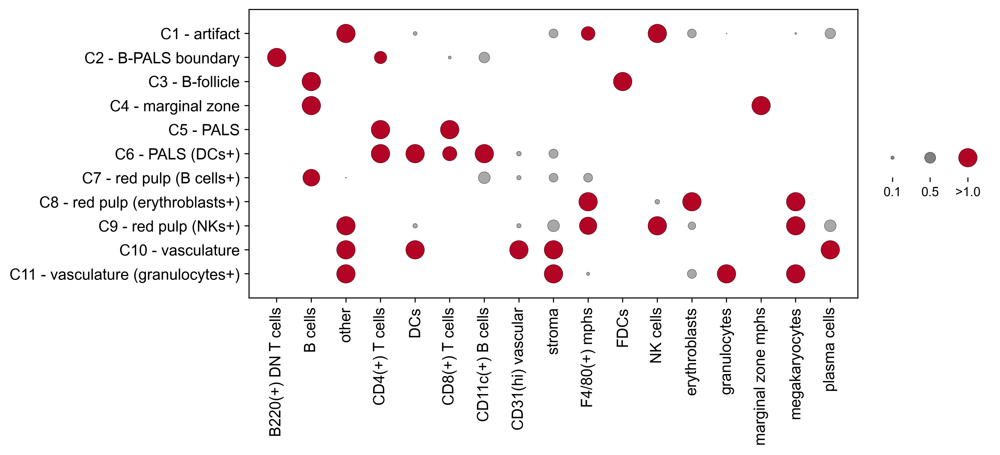

In [12]:
cc.gr.enrichment(
    adata,
    group_key='cell_type_reduced',
    label_key='spatial_cluster',
)
cc.pl.enrichment(
    adata,
    group_key='cell_type_reduced',
    label_key='spatial_cluster',
    size_threshold=1,
    color_threshold=0.58,
    cluster_labels=False,
    figsize=(10, 4),
)

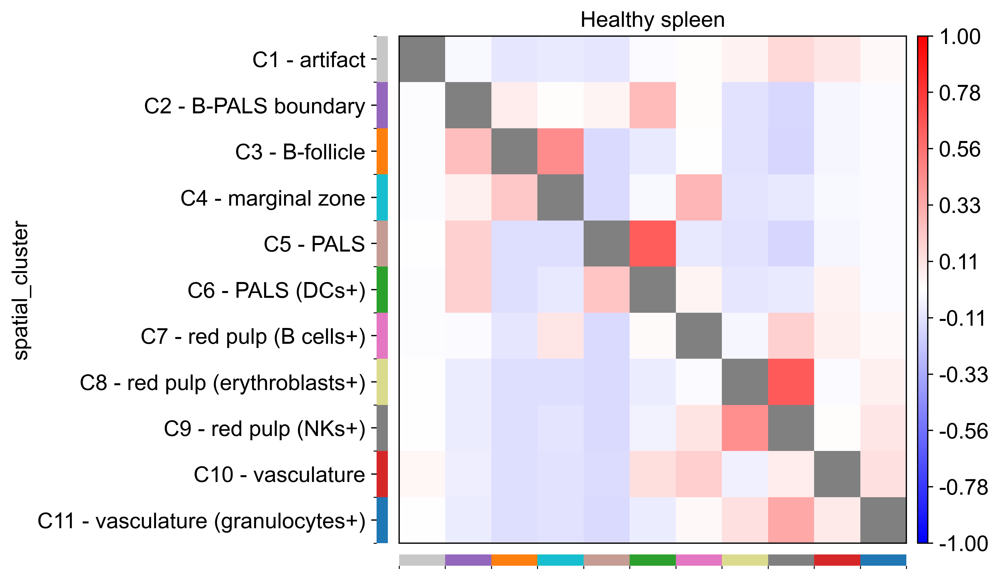

In [14]:
adata_balbc = adata[adata.obs['condition'] == 'BALBc']
cc.gr.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
)

cc.pl.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
    vmin=-1,
    vmax=1,
    title='Healthy spleen',
    figsize=(5, 5),
)

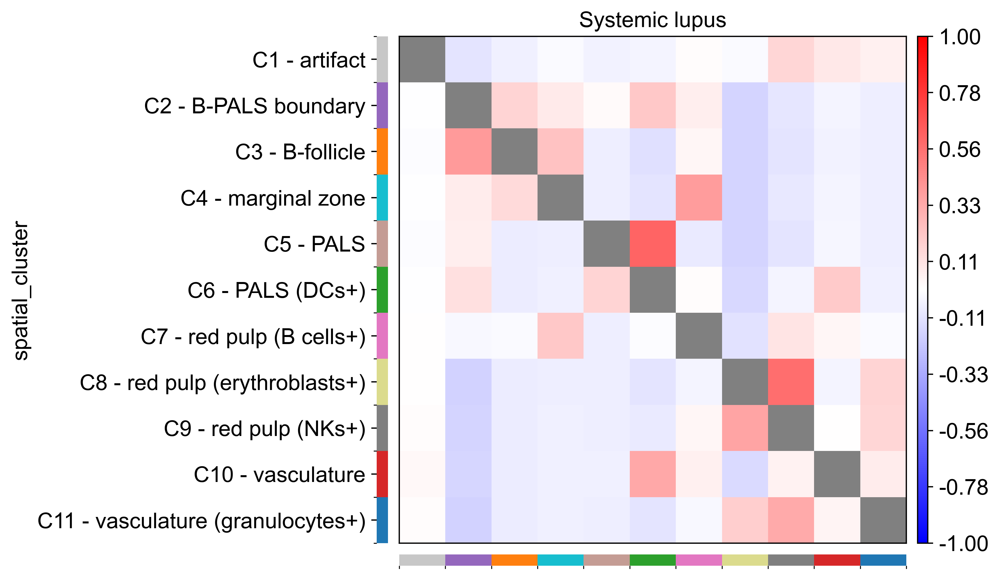

In [15]:
adata_balbc = adata[adata.obs['condition'] == 'MRL']
cc.gr.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
)

cc.pl.nhood_enrichment(
    adata_balbc,
    cluster_key='spatial_cluster',
    vmin=-1,
    vmax=1,
    title='Systemic lupus',
    figsize=(5, 5),
)

In [16]:
cc.gr.diff_nhood_enrichment(
    adata,
    cluster_key='spatial_cluster',
    condition_key='condition',
    condition_groups=['MRL', 'BALBc'],
    library_key='sample',
)

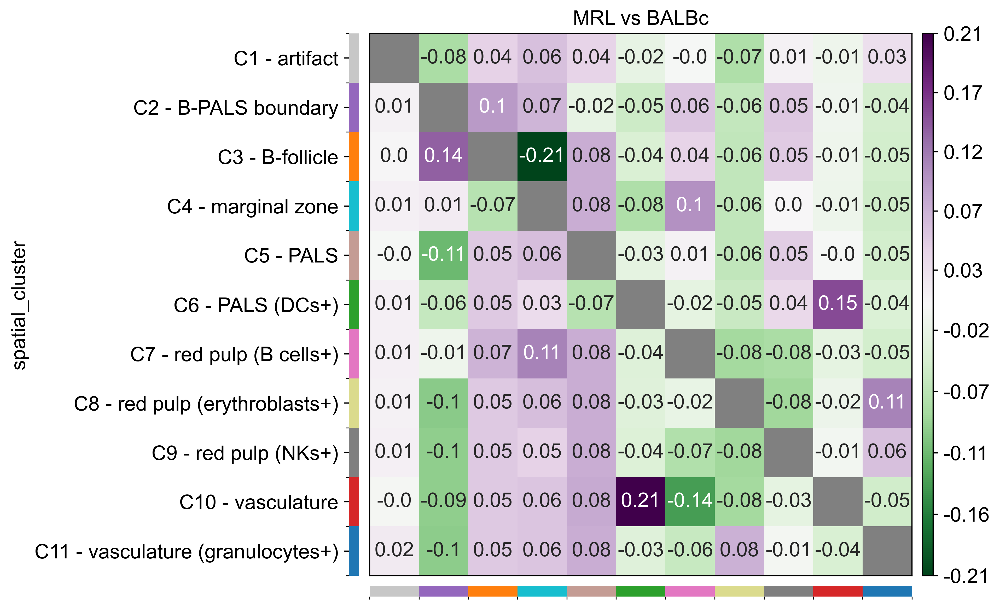

In [17]:
cc.pl.diff_nhood_enrichment(
    adata,
    cluster_key='spatial_cluster',
    condition_key='condition',
    condition_groups=['MRL', 'BALBc'],
    annotate=True,
    figsize=(7,7),
)

In [18]:
cc.gr.connected_components(adata, cluster_key='spatial_cluster')

In [19]:
cc.tl.boundaries(adata, min_hole_area_ratio=0.1)

In [20]:
cc.tl.linearity(adata)
cc.tl.curl(adata)

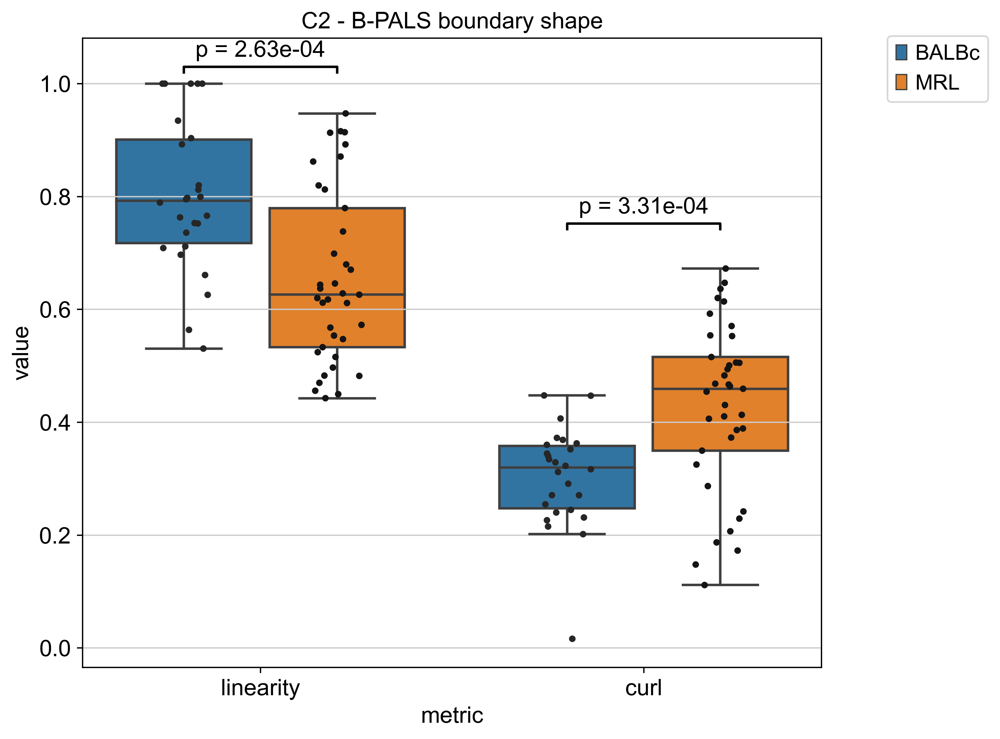

In [21]:
cc.pl.plot_shape_metrics(
    adata, 
    condition_key='condition', 
    condition_groups=['BALBc', 'MRL'],
    cluster_key='spatial_cluster', 
    cluster_id=['C2 - B-PALS boundary'], 
    title='C2 - B-PALS boundary shape'
)

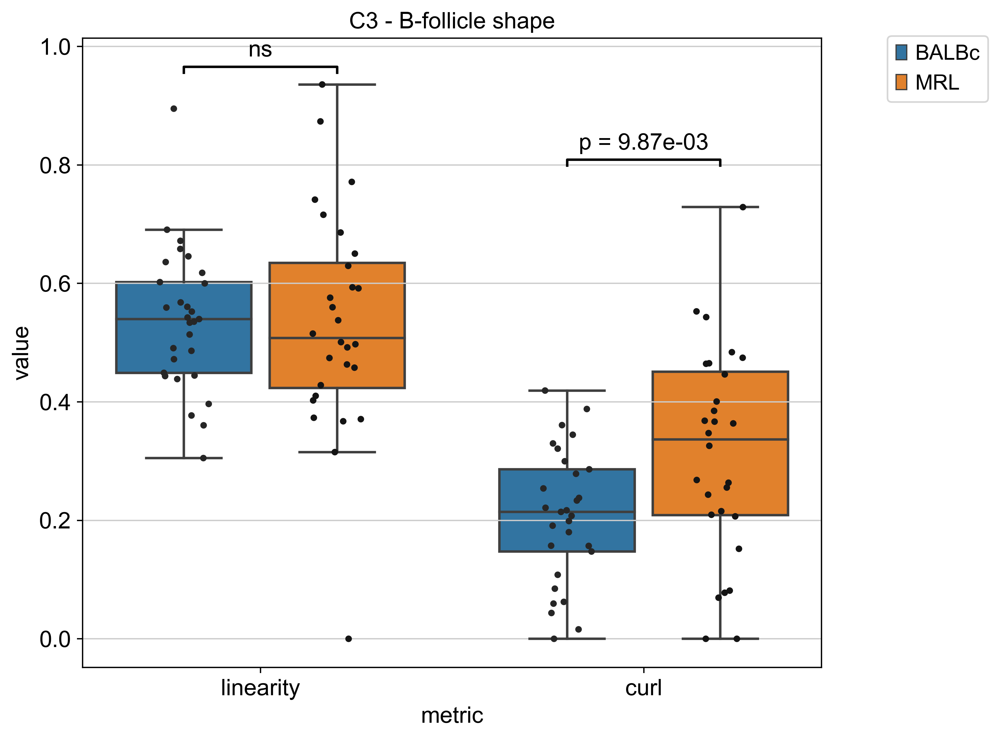

In [22]:
cc.pl.plot_shape_metrics(
    adata, 
    condition_key='condition', 
    condition_groups=['BALBc', 'MRL'],
    cluster_key='spatial_cluster', 
    cluster_id=['C3 - B-follicle'], 
    title='C3 - B-follicle shape'
)

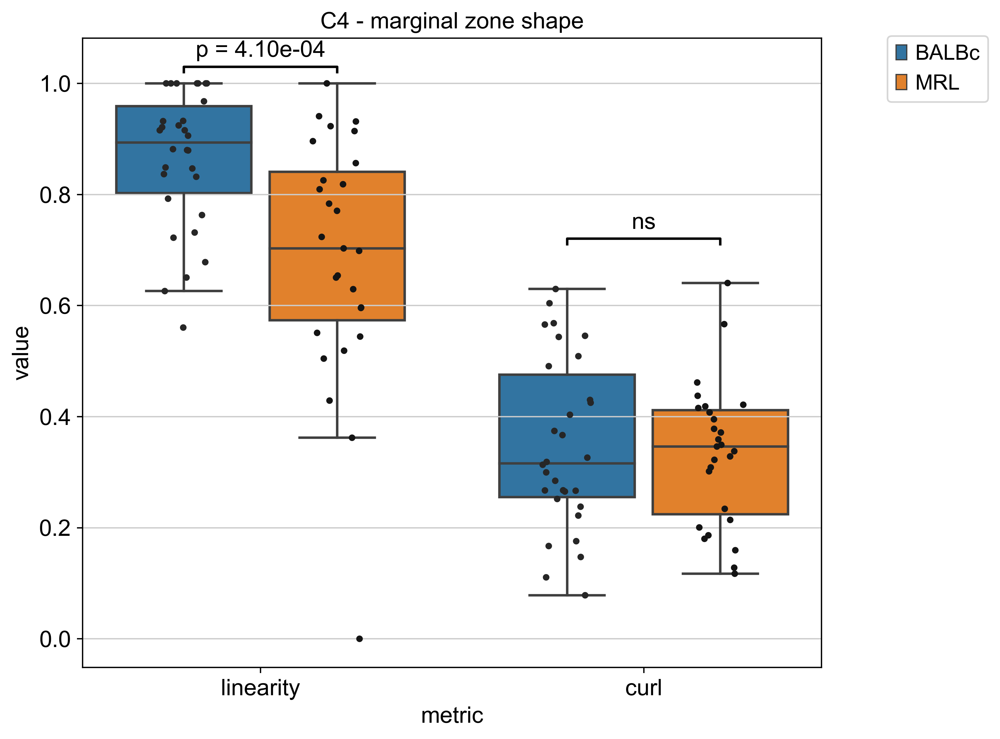

In [23]:
cc.pl.plot_shape_metrics(
    adata, 
    condition_key='condition', 
    condition_groups=['BALBc', 'MRL'],
    cluster_key='spatial_cluster', 
    cluster_id=['C4 - marginal zone'], 
    title='C4 - marginal zone shape'
)